In [2]:
import os
import cv2
import json
import math
import time
import tifffile
import numpy as np

from PIL import Image, ImageEnhance, ImageFilter
from collections import defaultdict

import matplotlib.pyplot as plt
from matplotlib import colormaps
import matplotlib.patches as patches
from matplotlib.backends.backend_pdf import PdfPages

from scipy.fft import fft2, fftshift
from scipy.spatial.distance import cdist

from skimage.color import rgb2lab
from skimage.feature import local_binary_pattern
from skimage.feature.texture import graycomatrix, graycoprops

from sklearn.preprocessing import normalize
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics.pairwise import cosine_similarity

In [3]:
parent_path = "../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne"

WSI_paths = [
    "/FFHO026/transfered_Xenium_Prime_Human_Ovary_FF_he_image.ome.tif",
    "/FFMB028/transfered_Xenium_Prime_Mouse_Brain_Coronal_FF_he_image.ome.tif",
    "/WMPW025/transfered_Xenium_Prime_Mouse_Pup_FFPE_he_image.ome.tif",
    "/FFMC016/transfered_Xenium_V1_mouse_Colon_FF_he_image.ome.tif",
    "/WMPP017/transfered_Xenium_V1_mouse_pup_he_image.ome.tif",
    "/PDHP030/transfered_Xenium_Prime_Human_Prostate_FFPE_he_image.ome.tif",
    "/PDHS029/transfered_Xenium_Prime_Human_Skin_FFPE_he_image.ome.tif",
    "/HHDX011/transfered_Xenium_V1_hHeart_nondiseased_section_FFPE_he_image.ome.tif",
    "/HPXM007/transfered_Xenium_V1_human_Pancreas_FFPE_he_image.ome.tif",
    "/HSDX009/transfered_Xenium_V1_hSkin_nondiseased_section_1_FFPE_he_image.ome.tif",
]

WSI_paths = [parent_path+wsi_path for wsi_path in WSI_paths]

WSI_paths

['../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/FFHO026/transfered_Xenium_Prime_Human_Ovary_FF_he_image.ome.tif',
 '../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/FFMB028/transfered_Xenium_Prime_Mouse_Brain_Coronal_FF_he_image.ome.tif',
 '../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/WMPW025/transfered_Xenium_Prime_Mouse_Pup_FFPE_he_image.ome.tif',
 '../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/FFMC016/transfered_Xenium_V1_mouse_Colon_FF_he_image.ome.tif',
 '../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/WMPP017/transfered_Xenium_V1_mouse_pup_he_image.ome.tif',
 '../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/PDHP030/transfered_Xenium_Prime_Human_Prostate_FFPE_he_image.ome.tif',
 '../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/PDHS029/transfered_Xenium_Prime_Human_Skin_FFPE_he_image.ome.tif',
 '../../../../../

In [4]:
def crop_and_enhance(input_path):
    output_path = os.path.splitext(input_path)[0] + "_cutout.jpg"

    wsi_width, wsi_height = 0, 0
    x0, y0 = 0, 0

    # Use tifffile to read only required metadata and region
    with tifffile.TiffFile(input_path) as tif:
        image = tif.pages[0]
        wsi_height, wsi_width = image.shape[0], image.shape[1]  # shape is (rows, cols)

        crop_length = min(int(wsi_width * 0.5), int(wsi_height * 0.5))
        x0 = (wsi_width - crop_length) // 2
        y0 = (wsi_height - crop_length) // 2

        # Efficiently read just the region of interest
        region_array = image.asarray()[y0:y0 + crop_length, x0:x0 + crop_length]

    # Convert to PIL Image (handle grayscale or RGB)
    if region_array.ndim == 2:  # Grayscale
        img = Image.fromarray(region_array, mode='L')
    elif region_array.shape[2] == 3:
        img = Image.fromarray(region_array, mode='RGB')
    elif region_array.shape[2] == 4:  # RGBA
        img = Image.fromarray(region_array[:, :, :3], mode='RGB')
    else:
        raise ValueError("Unsupported TIFF format: shape {}".format(region_array.shape))

    print(f"Center crop saved. Top-left corner: ({x0}, {y0}), Size: {crop_length}x{crop_length}")
    num_patches = (math.ceil(crop_length / 200)) ** 2
    print(f"Estimated no. of patches: {num_patches}")

    # Image enhancement
    denoised = img.filter(ImageFilter.GaussianBlur(radius=1.0))
    contrasted = ImageEnhance.Contrast(denoised).enhance(2.0)
    sharpened = ImageEnhance.Sharpness(contrasted).enhance(2.0)

    sharpened.save(output_path)
    print(f"Saved enhanced center crop to {output_path}")

    return wsi_width, wsi_height, (x0, y0), output_path

In [5]:
# === Image Comparison Metrics ===

def extract_color_histogram(patch_rgb):
    """Extract color histogram features in LAB color space."""
    lab = rgb2lab(patch_rgb)
    hist = []
    for i in range(3):
        channel_range = (0, 100) if i == 0 else (-128, 128)
        h, _ = np.histogram(lab[..., i], bins=16, range=channel_range, density=True)
        hist.append(h)
    return np.concatenate(hist)

def extract_lbp_hist(patch_gray, radius=1, n_points=8):
    """Extract Local Binary Pattern histogram."""
    lbp = local_binary_pattern(patch_gray, n_points, radius, method='uniform')
    hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, n_points + 3),
                           range=(0, n_points + 2), density=True)
    return hist

def extract_haralick(patch_gray):
    """Extract Haralick texture features from GLCM."""
    patch_gray = patch_gray.astype(np.uint8)
    glcm = graycomatrix(patch_gray, distances=[1], angles=[0],
                        levels=256, symmetric=True, normed=True)
    feats = [graycoprops(glcm, p).flatten()[0] for p in ['contrast', 'correlation', 'energy', 'homogeneity']]
    return np.array(feats)

def extract_fft_features(patch_gray):
    """Extract FFT radial profile features."""
    f = fft2(patch_gray)
    fshift = fftshift(f)
    magnitude_spectrum = np.abs(fshift)
    rad_profile = np.mean(magnitude_spectrum, axis=0)
    return normalize([rad_profile[:32]])[0]

def pad_patch(patch, min_size=32):
    """Pad patch to at least (min_size, min_size) dimensions."""
    h, w = patch.shape[:2]
    pad_h = max(0, min_size - h)
    pad_w = max(0, min_size - w)
    if pad_h > 0 or pad_w > 0:
        patch = np.pad(patch, ((0, pad_h), (0, pad_w), (0, 0)), mode='reflect')
    return patch

def extract_features(patch_rgb, min_size=32):
    """Extract all features for a patch, auto-pad if too small."""
    patch_rgb = pad_patch(patch_rgb, min_size=min_size)
    color_feat = extract_color_histogram(patch_rgb)

    gray = np.mean(patch_rgb, axis=2).astype(np.uint8)
    lbp_feat = extract_lbp_hist(gray)
    haralick_feat = extract_haralick(gray)

    return {
        'color': color_feat,
        'lbp': lbp_feat,
        'haralick': haralick_feat,
    }


def is_mostly_empty(img_np, white_thresh=220, white_ratio_thresh=0.95, std_thresh=15, downsample_to=64):
    """
    Blazing-fast blank patch detector using OpenCV and downsampling.
    
    Args:
        img_np: RGB NumPy array of shape (H, W, 3)
        white_thresh: pixel brightness threshold to consider as white
        white_ratio_thresh: threshold for ratio of white pixels
        std_thresh: standard deviation threshold for low-content
        downsample_to: target resolution for faster analysis
    
    Returns:
        True if patch is considered mostly empty
    """
    # Downsample image for speed
    small = cv2.resize(img_np, (downsample_to, downsample_to), interpolation=cv2.INTER_AREA)

    # Convert to grayscale
    gray = cv2.cvtColor(small, cv2.COLOR_RGB2GRAY)

    # Compute white pixel ratio
    white_pixels = np.sum(gray > white_thresh)
    total_pixels = gray.size
    white_ratio = white_pixels / total_pixels

    # Compute standard deviation (for low-content check)
    stddev = np.std(gray)

    return white_ratio > white_ratio_thresh or stddev < std_thresh

In [6]:
# --- Recursive Region Splitting ---
def split_region(x_pos, y_pos, width, height, np_image, region_list, next_region_id,
                 min_patch_size=8, similarity_threshold=0.98,
                 is_initial_split=False, initial_split_factor=4):

    patch = np_image[y_pos:y_pos+height, x_pos:x_pos+width]
    centroid = (x_pos + width / 2, y_pos + height / 2)

    # If patch width or patch height is smaller than min_patch_size, do not split further
    if width <= min_patch_size or height <= min_patch_size:
        features = extract_features(patch)
        feature_vector = np.concatenate([features['color'], features['lbp'], features['haralick']])

        region_list.append({
            'id': next_region_id,
            'x': x_pos, 'y': y_pos, 'w': width, 'h': height,
            'feature': feature_vector,
            'centroid': centroid,
            'bbox': (x_pos, y_pos, width, height)
        })
        return next_region_id + 1


    split_factor = initial_split_factor if is_initial_split else 2
    subpatch_width, subpatch_height = width // split_factor, height // split_factor

    subpatches = []
    for i in range(split_factor):
        for j in range(split_factor):
            sub_x = x_pos + i * subpatch_width
            sub_y = y_pos + j * subpatch_height
            sub_w = subpatch_width if i < split_factor - 1 else width - i * subpatch_width
            sub_h = subpatch_height if j < split_factor - 1 else height - j * subpatch_height
            subpatches.append((sub_x, sub_y, sub_w, sub_h))

    subpatch_features = []
    for (sx, sy, sw, sh) in subpatches:
        sub_patch = np_image[sy:sy+sh, sx:sx+sw]
        features = extract_features(sub_patch)
        subpatch_features.append(features)

    similarity_scores = []
    for i in range(len(subpatches)):
        for j in range(i+1, len(subpatches)):
            f1, f2 = subpatch_features[i], subpatch_features[j]

            color_sim = cosine_similarity([f1['color']], [f2['color']])[0][0]
            lbp_sim = cosine_similarity([f1['lbp']], [f2['lbp']])[0][0]
            haralick_sim = cosine_similarity([f1['haralick']], [f2['haralick']])[0][0]

            combined_score = 25 * color_sim + 25 * lbp_sim + 50 * haralick_sim
            similarity_scores.append(combined_score)

    avg_similarity = np.median(similarity_scores)/100
    is_full_image = (x_pos == 0 and y_pos == 0 and width == np_image.shape[1] and height == np_image.shape[0])
   
    if is_mostly_empty(patch): 
        return next_region_id        
            
    if avg_similarity > similarity_threshold and not is_full_image:
        features = extract_features(patch)
        feature_vector = np.concatenate([features['color'], features['lbp'], features['haralick']])

        region_list.append({
            'id': next_region_id,
            'x': x_pos, 'y': y_pos, 'w': width, 'h': height,
            'feature': feature_vector,
            'centroid': centroid,
            'bbox': (x_pos, y_pos, width, height),
            'score': avg_similarity
        })
        return next_region_id + 1

    for (sx, sy, sw, sh) in subpatches:
        next_region_id = split_region(sx, sy, sw, sh, np_image, region_list, next_region_id,
                                       min_patch_size=min_patch_size,
                                       similarity_threshold=similarity_threshold,
                                       is_initial_split=False,
                                       initial_split_factor=initial_split_factor)

    return next_region_id

In [7]:
# --- Process Image ---
def process_image(image_path, resize_to=512, min_patch_size=8, similarity_threshold=0.975, to_split=False, initial_split_factor=4):
    """Load an image, perform recursive splitting, and extract regions."""
    image = Image.open(image_path).convert('RGB')
    image = image.resize((resize_to, resize_to))
    image_np = np.array(image)

    print("Done resizing image.")

    regions = []
    starting_region_id = 0

    split_region(0, 0, image_np.shape[1], image_np.shape[0],
                 image_np, regions, starting_region_id,
                 min_patch_size=min_patch_size,
                 similarity_threshold=similarity_threshold,
                 is_initial_split=to_split,
                 initial_split_factor=initial_split_factor)

    return regions, image_np

In [8]:
def merge_clusters_with_dp(regions, img_diagonal, sim_thresholds={'color': 0.99}, distance_threshold=0.001):
    if len(regions) < 2:
        return [0 for _ in regions]

    # Use full feature + centroid for initial clustering
    features = np.array([
        np.concatenate([r['feature'], np.array(r['centroid']) / img_diagonal])
        for r in regions
    ])
    dist_matrix = cdist(features, features, metric='cosine')
    n_clusters = max(1, len(regions) // 10)

    clustering = AgglomerativeClustering(n_clusters=n_clusters, metric='precomputed', linkage='average')
    labels = clustering.fit_predict(dist_matrix)

    # Assign preliminary labels
    cluster_map = defaultdict(list)
    for region, label in zip(regions, labels):
        region['label'] = label
        cluster_map[label].append(region)

    # Extract only color and centroid features per cluster
    cluster_features = {}
    for label, members in cluster_map.items():
        color_feats = [r['feature'][14:62] for r in members]  # Adjust if color dims change
        centroid = np.mean([r['centroid'] for r in members], axis=0)
        cluster_features[label] = {
            'color': np.mean(color_feats, axis=0),
            'centroid': centroid
        }

    # Build once
    adjacency = defaultdict(set)
    
    for i, r1 in enumerate(regions):
        for j, r2 in enumerate(regions[i+1:], start=i+1):
            x1, y1, w1, h1 = r1['bbox']
            x2, y2, w2, h2 = r2['bbox']
            if abs(x1 - x2) <= max(w1, w2) and abs(y1 - y2) <= max(h1, h2):
                adjacency[r1['label']].add(r2['label'])
                adjacency[r2['label']].add(r1['label'])  # bidirectional


    # DFS-based cluster merging using color + distance
    dp_merge = {}

    def dfs(label, cluster_id):
        if label in dp_merge:
            return
        dp_merge[label] = cluster_id
        for neighbor in adjacency[label]:
            if neighbor in dp_merge:
                continue
            cf1, cf2 = cluster_features[label], cluster_features[neighbor]
            sim_col = cosine_similarity([cf1['color']], [cf2['color']])[0][0]
            dist = np.linalg.norm(cf1['centroid'] - cf2['centroid']) / img_diagonal
            if sim_col > sim_thresholds['color'] and dist < distance_threshold:
                dfs(neighbor, cluster_id)

    # Initial merging
    current_cluster_id = 0
    for label in cluster_features:
        if label not in dp_merge:
            dfs(label, current_cluster_id)
            current_cluster_id += 1

    # --- Post-hoc Region Growing (Color only, relaxed threshold) ---
    # Reverse map: cluster_id → labels (merged groups)
    merged_cluster_to_labels = defaultdict(set)
    for label, cluster_id in dp_merge.items():
        merged_cluster_to_labels[cluster_id].add(label)

    # Build cluster-level adjacency
    cluster_adjacency = defaultdict(set)
    for label1 in dp_merge:
        for label2 in adjacency[label1]:
            cid1, cid2 = dp_merge[label1], dp_merge[label2]
            if cid1 != cid2:
                cluster_adjacency[cid1].add(cid2)

    # Assign final merged labels
    final_labels = [dp_merge[r['label']] for r in regions]
        
    return final_labels


In [9]:
def visualize_regions(image_path, regions, final_labels, img_np,
                      base_overlay=0.4, annotate=False):
    image_name = os.path.splitext(os.path.basename(image_path))[0]

    unique_labels = sorted(set(final_labels))
    cmap = colormaps.get_cmap('nipy_spectral').resampled(len(unique_labels))

    label_to_color = {
        label: tuple(cmap(i)[:3])  # RGB only
        for i, label in enumerate(unique_labels)
    }

    def brighten(rgb, factor=1.4):
        return tuple(min(1.0, c * factor) for c in rgb)

    for alpha in [base_overlay, 1.0]:
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(img_np)
        for region, label in zip(regions, final_labels):
            color = label_to_color[label]
            facecolor_rgba = (*color, alpha)
            border_color = brighten(color, 1.5)

            rect = patches.Rectangle((region['x'], region['y']), region['w'], region['h'],
                                     linewidth=1.0, edgecolor=border_color, facecolor=facecolor_rgba)
            ax.add_patch(rect)

            if annotate:
                ax.text(region['x'], region['y'], f"C{label}", fontsize=6,
                        color=brighten(color, 2.0), weight='bold')

        ax.set_title(f"Regions (Overlay {int(alpha*100)}%) for {image_name}")
        ax.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()

def visualize_regions_to_pdf(image_path, regions, final_labels, img_np,
                             pdf, base_overlay=0.4, annotate=False):
    image_name = os.path.splitext(os.path.basename(image_path))[0]

    unique_labels = sorted(set(final_labels))
    cmap = colormaps.get_cmap('nipy_spectral').resampled(len(unique_labels))

    label_to_color = {
        label: tuple(cmap(i)[:3])  # RGB only
        for i, label in enumerate(unique_labels)
    }

    def brighten(rgb, factor=1.4):
        return tuple(min(1.0, c * factor) for c in rgb)

    for alpha in [base_overlay, 1.0]:
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(img_np)
        for region, label in zip(regions, final_labels):
            color = label_to_color[label]
            facecolor_rgba = (*color, alpha)
            border_color = brighten(color, 1.5)

            rect = patches.Rectangle((region['x'], region['y']), region['w'], region['h'],
                                     linewidth=1.0, edgecolor=border_color, facecolor=facecolor_rgba)
            ax.add_patch(rect)

            if annotate:
                ax.text(region['x'], region['y'], f"C{label}", fontsize=6,
                        color=brighten(color, 2.0), weight='bold')

        ax.set_title(f"Regions (Overlay {int(alpha*100)}%) for {image_name}")
        ax.axis("off")
        plt.tight_layout()
        plt.show()
        pdf.savefig(fig)
        plt.close()

../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/FFHO026/transfered_Xenium_Prime_Human_Ovary_FF_he_image.ome.tif
Center crop saved. Top-left corner: (2842, 7980), Size: 5684x5684
Estimated no. of patches: 841
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/FFHO026/transfered_Xenium_Prime_Human_Ovary_FF_he_image.ome_cutout.jpg
WSI Width: 11368 | WSI Height: 21644
Minimum region size = 19
Done resizing image.
❗ WARNING: patch_2199.tif already assigned to Cluster 1, skipping for Cluster 2
❗ WARNING: patch_2423.tif already assigned to Cluster 2, skipping for Cluster 0
❗ WARNING: patch_2479.tif already assigned to Cluster 2, skipping for Cluster 0
❗ WARNING: patch_2591.tif already assigned to Cluster 3, skipping for Cluster 2
❗ WARNING: patch_2815.tif already assigned to Cluster 2, skipping for Cluster 3
❗ WARNING: patch_2983.tif already assigned to Cluster 2, skipping for Cluster 3
❗ WARNING: patch_3095.tif alread

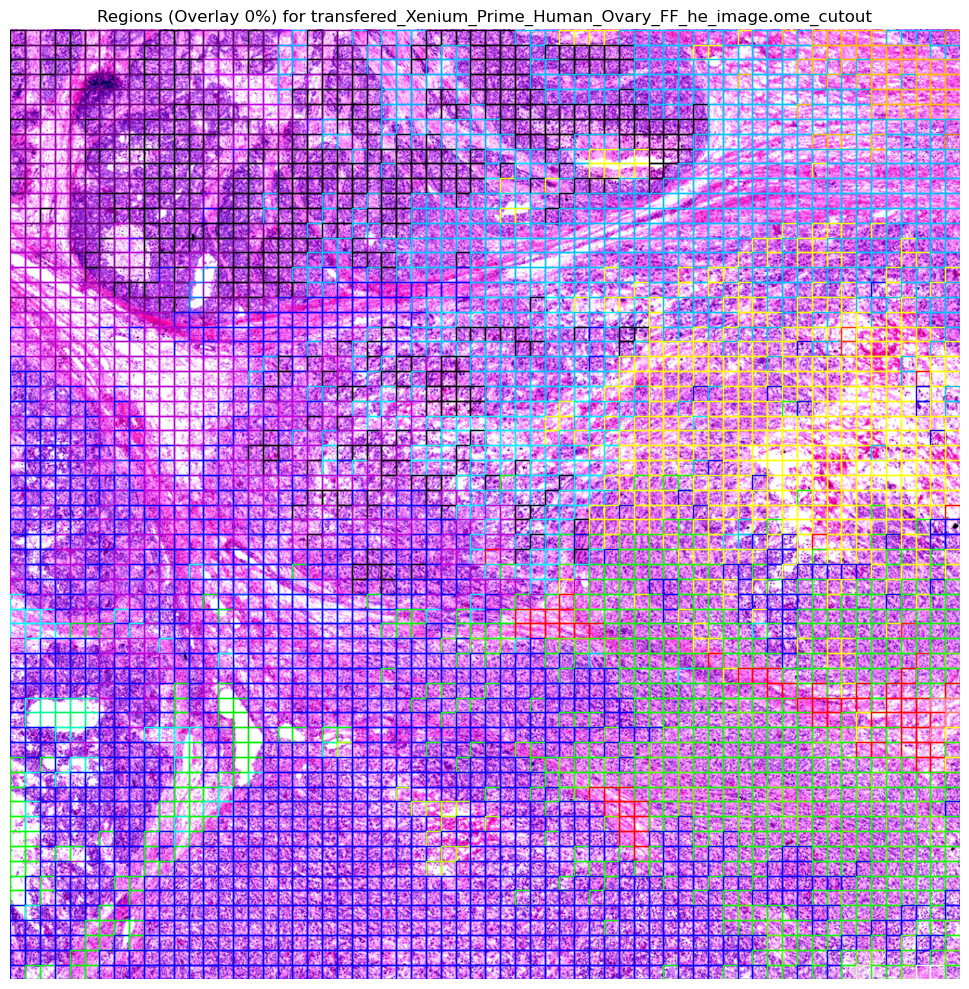

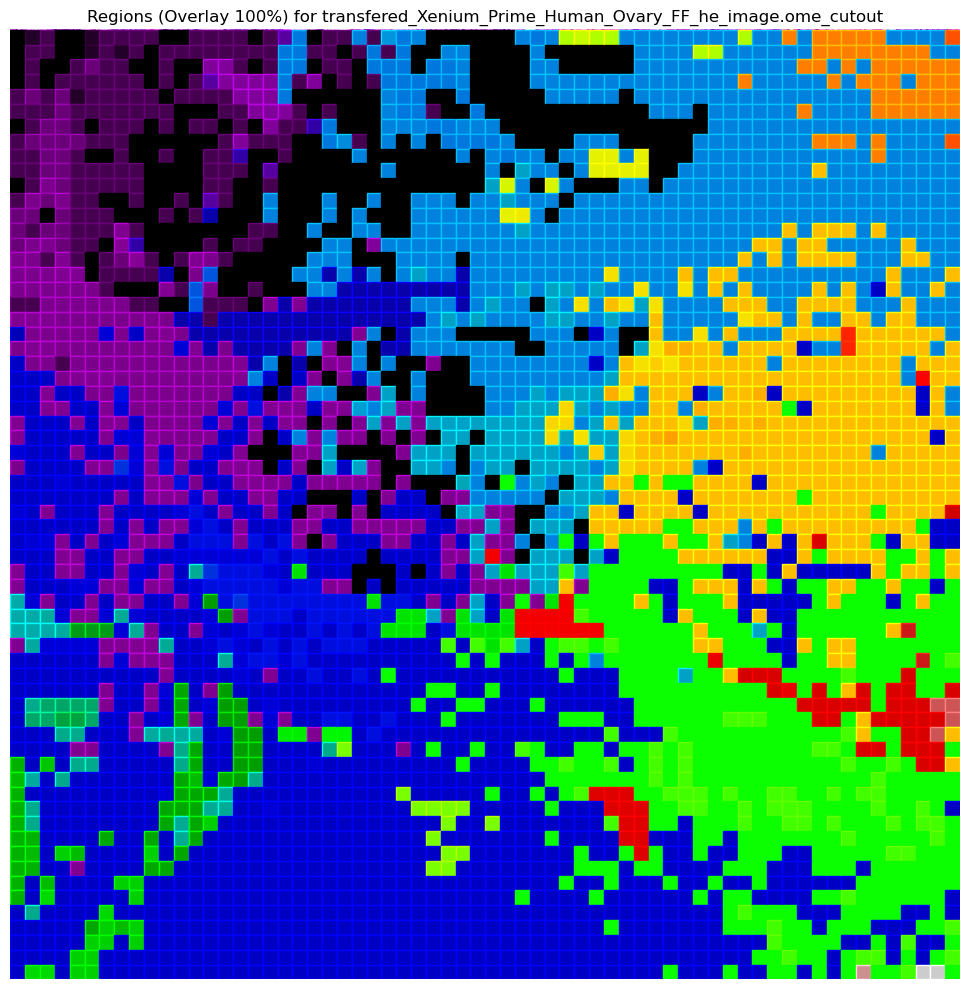

Done with image #1 (FFHO026) | Time taken: 35.2
Saved cluster → patch mapping to cluster_to_patch_ids_FFHO026.json
../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/FFMB028/transfered_Xenium_Prime_Mouse_Brain_Coronal_FF_he_image.ome.tif
Center crop saved. Top-left corner: (2216, 1172), Size: 2344x2344
Estimated no. of patches: 144
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/FFMB028/transfered_Xenium_Prime_Mouse_Brain_Coronal_FF_he_image.ome_cutout.jpg
WSI Width: 6777 | WSI Height: 4689
Minimum region size = 44
Done resizing image.


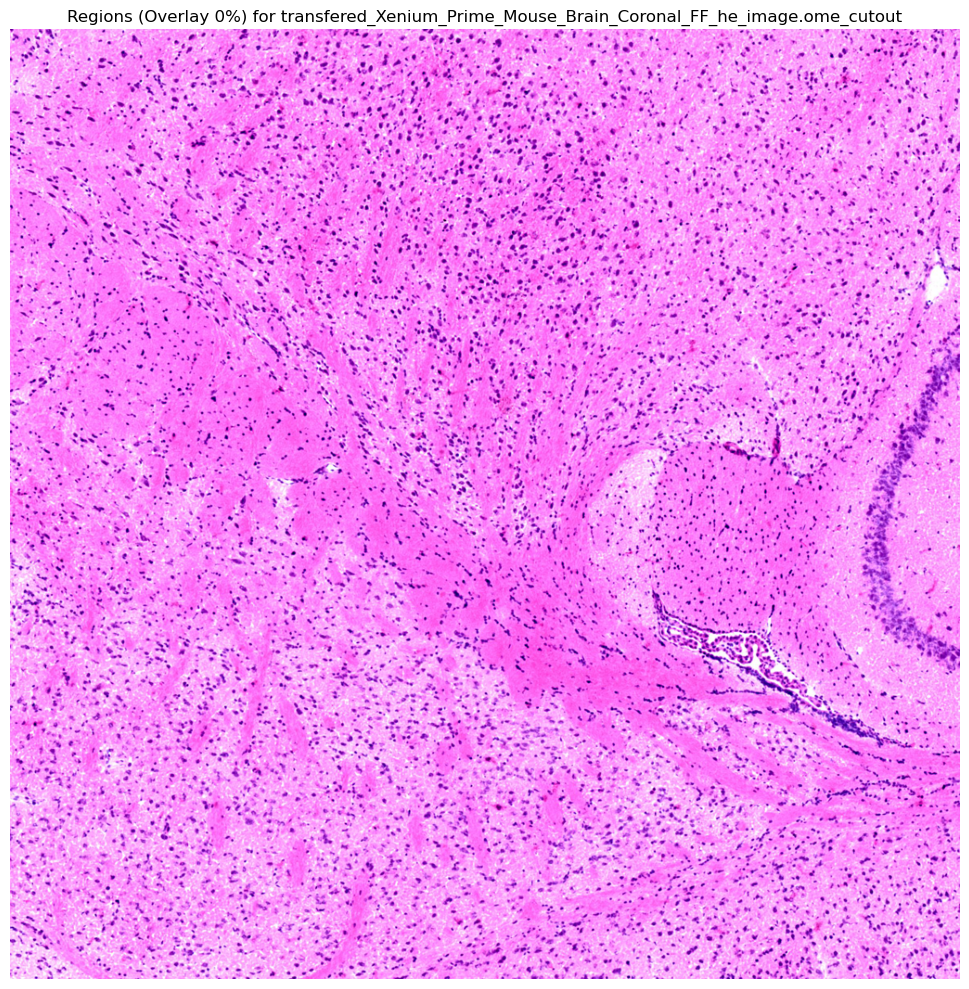

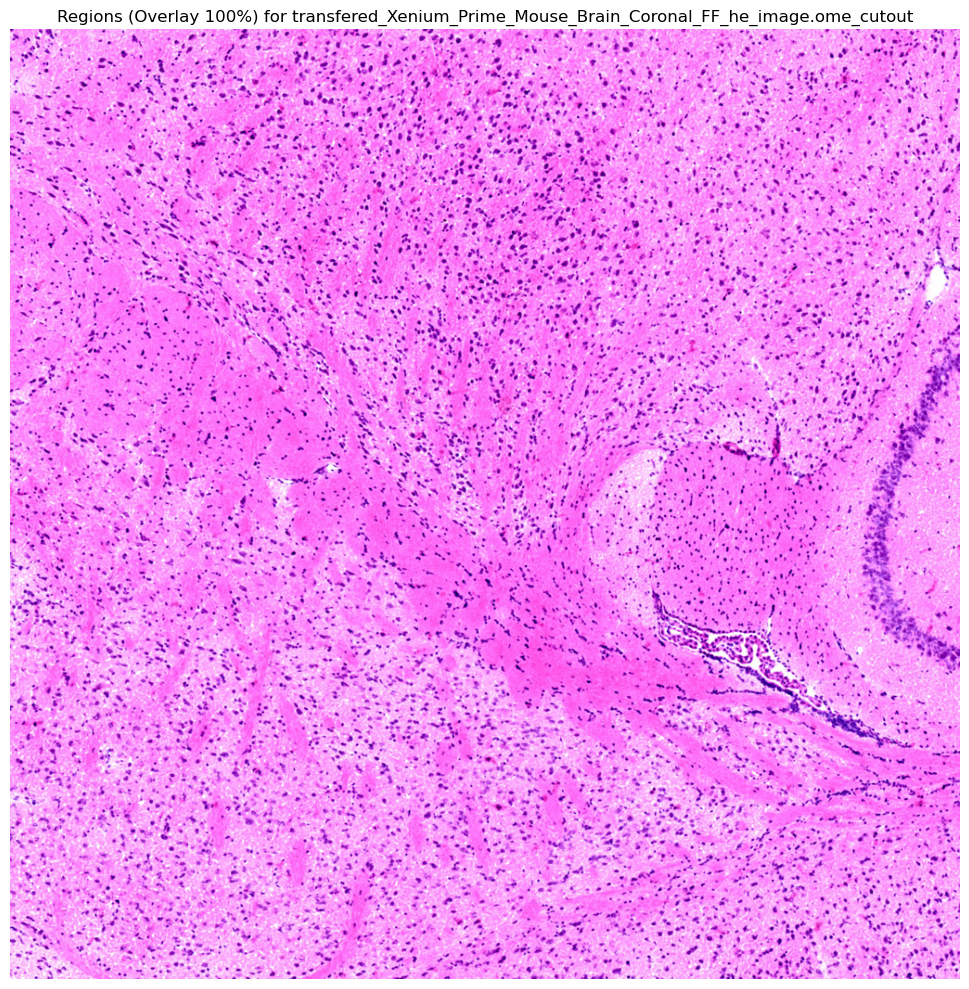

Done with image #2 (FFMB028) | Time taken: 0.9
Saved cluster → patch mapping to cluster_to_patch_ids_FFMB028.json
../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/WMPW025/transfered_Xenium_Prime_Mouse_Pup_FFPE_he_image.ome.tif
Center crop saved. Top-left corner: (4259, 8212), Size: 8519x8519
Estimated no. of patches: 1849
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/WMPW025/transfered_Xenium_Prime_Mouse_Pup_FFPE_he_image.ome_cutout.jpg
WSI Width: 17038 | WSI Height: 24943
Minimum region size = 13
Done resizing image.
❗ WARNING: patch_3676.tif already assigned to Cluster 0, skipping for Cluster 1
❗ WARNING: patch_3676.tif already assigned to Cluster 0, skipping for Cluster 1
❗ WARNING: patch_3677.tif already assigned to Cluster 1, skipping for Cluster 0
❗ WARNING: patch_3846.tif already assigned to Cluster 0, skipping for Cluster 1
❗ WARNING: patch_3931.tif already assigned to Cluster 0, skipping for Cluster

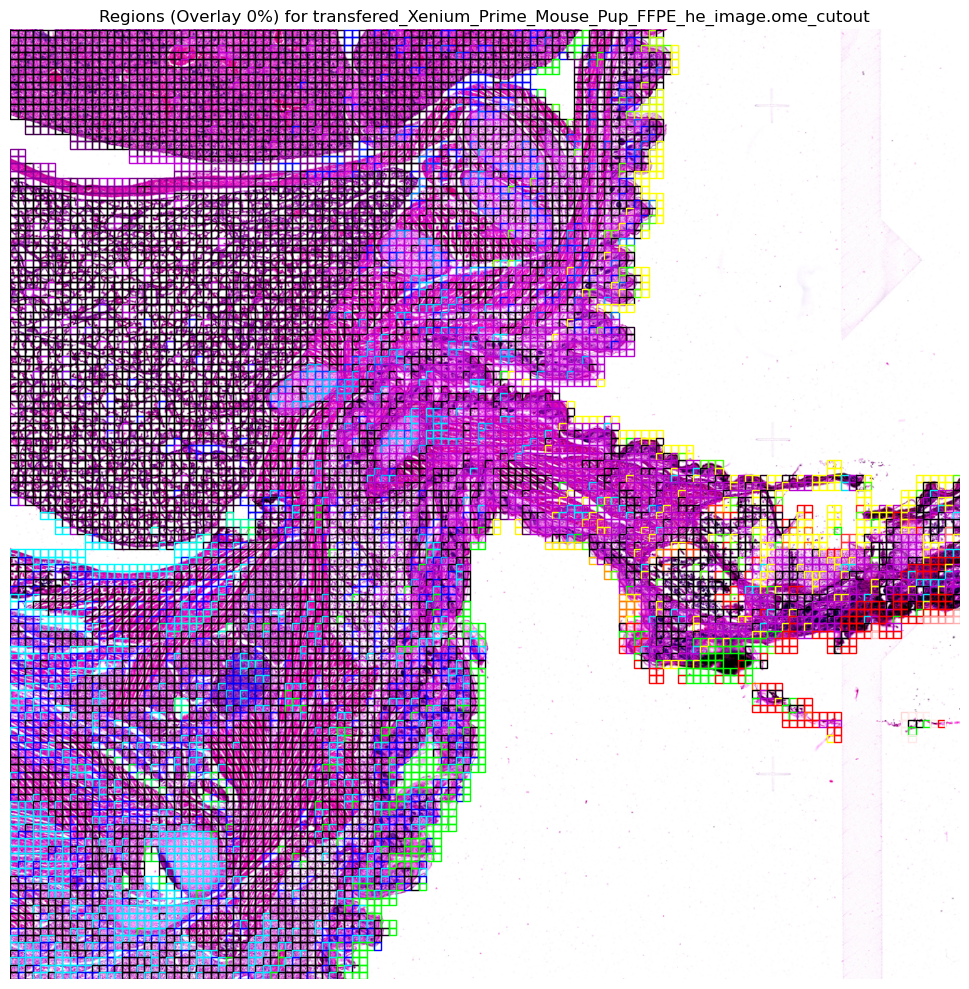

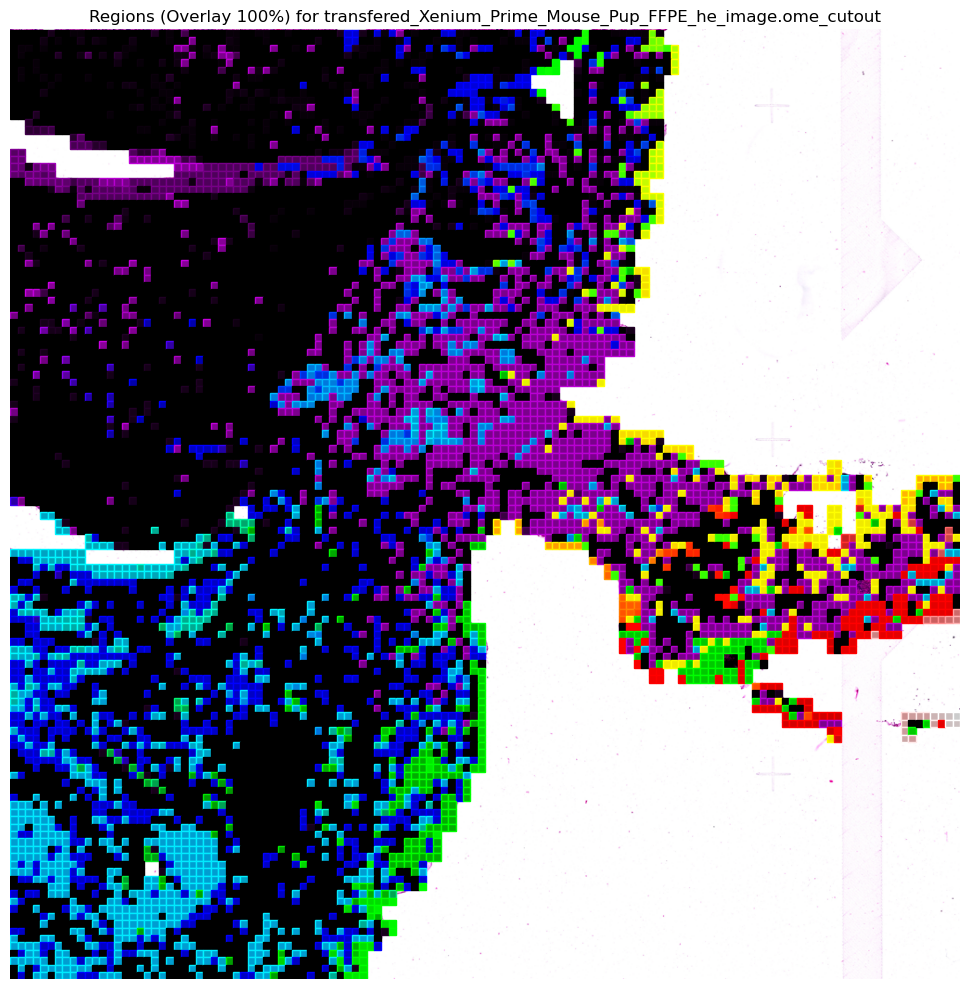

Done with image #3 (WMPW025) | Time taken: 97.4
Saved cluster → patch mapping to cluster_to_patch_ids_WMPW025.json
../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/FFMC016/transfered_Xenium_V1_mouse_Colon_FF_he_image.ome.tif
Center crop saved. Top-left corner: (1949, 2476), Size: 3897x3897
Estimated no. of patches: 400
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/FFMC016/transfered_Xenium_V1_mouse_Colon_FF_he_image.ome_cutout.jpg
WSI Width: 7795 | WSI Height: 8850
Minimum region size = 27
Done resizing image.
❗ WARNING: patch_580.tif already assigned to Cluster 3, skipping for Cluster 2
❗ WARNING: patch_468.tif already assigned to Cluster 6, skipping for Cluster 0
❗ WARNING: patch_506.tif already assigned to Cluster 7, skipping for Cluster 0
❗ WARNING: patch_506.tif already assigned to Cluster 7, skipping for Cluster 0
❗ WARNING: patch_506.tif already assigned to Cluster 7, skipping for Cluster 0
❗ WARNING:

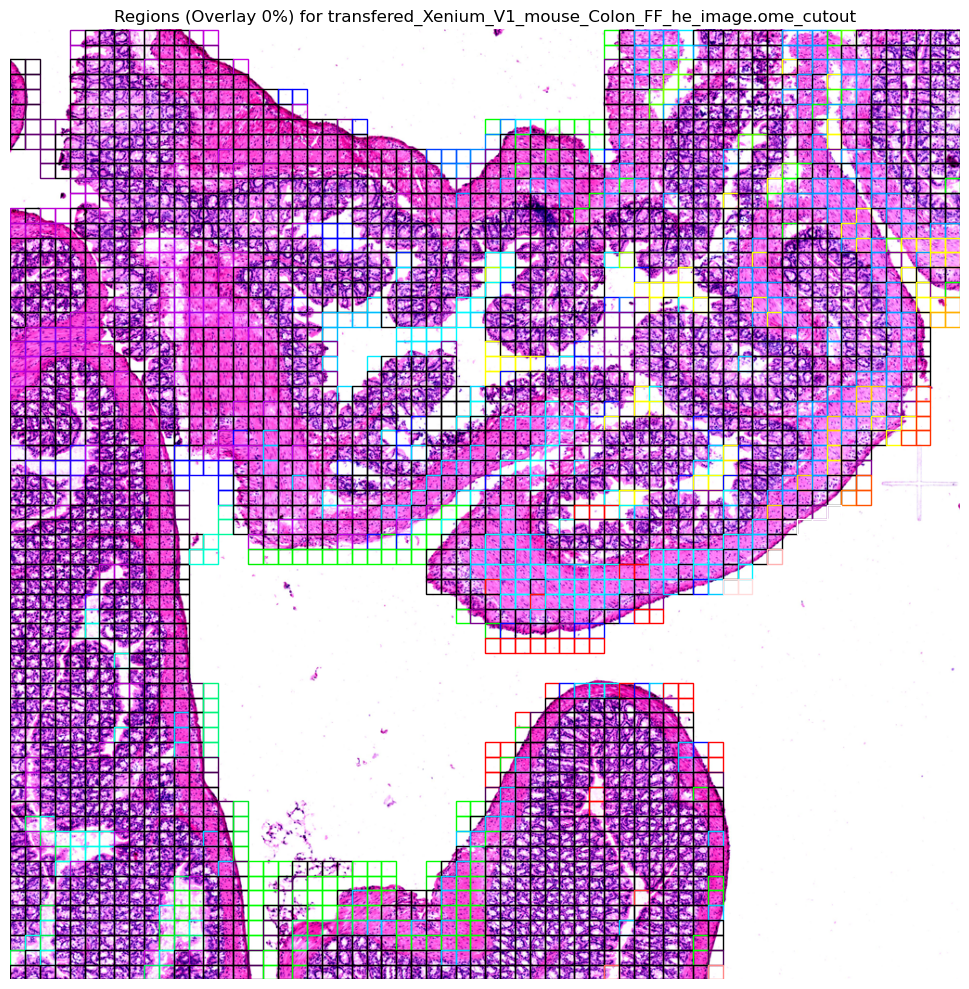

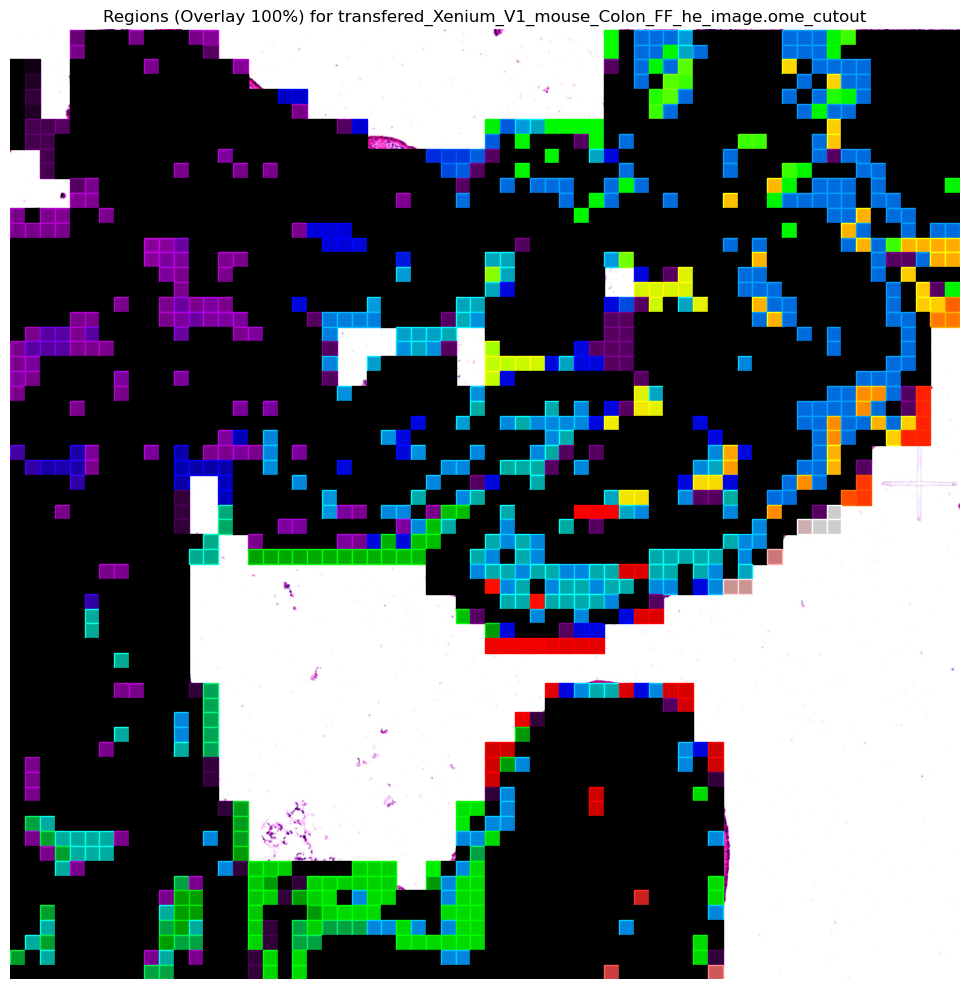

Done with image #4 (FFMC016) | Time taken: 25.6
Saved cluster → patch mapping to cluster_to_patch_ids_FFMC016.json
../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/WMPP017/transfered_Xenium_V1_mouse_pup_he_image.ome.tif
Center crop saved. Top-left corner: (3399, 7830), Size: 6799x6799
Estimated no. of patches: 1156
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/WMPP017/transfered_Xenium_V1_mouse_pup_he_image.ome_cutout.jpg
WSI Width: 13598 | WSI Height: 22460
Minimum region size = 16
Done resizing image.


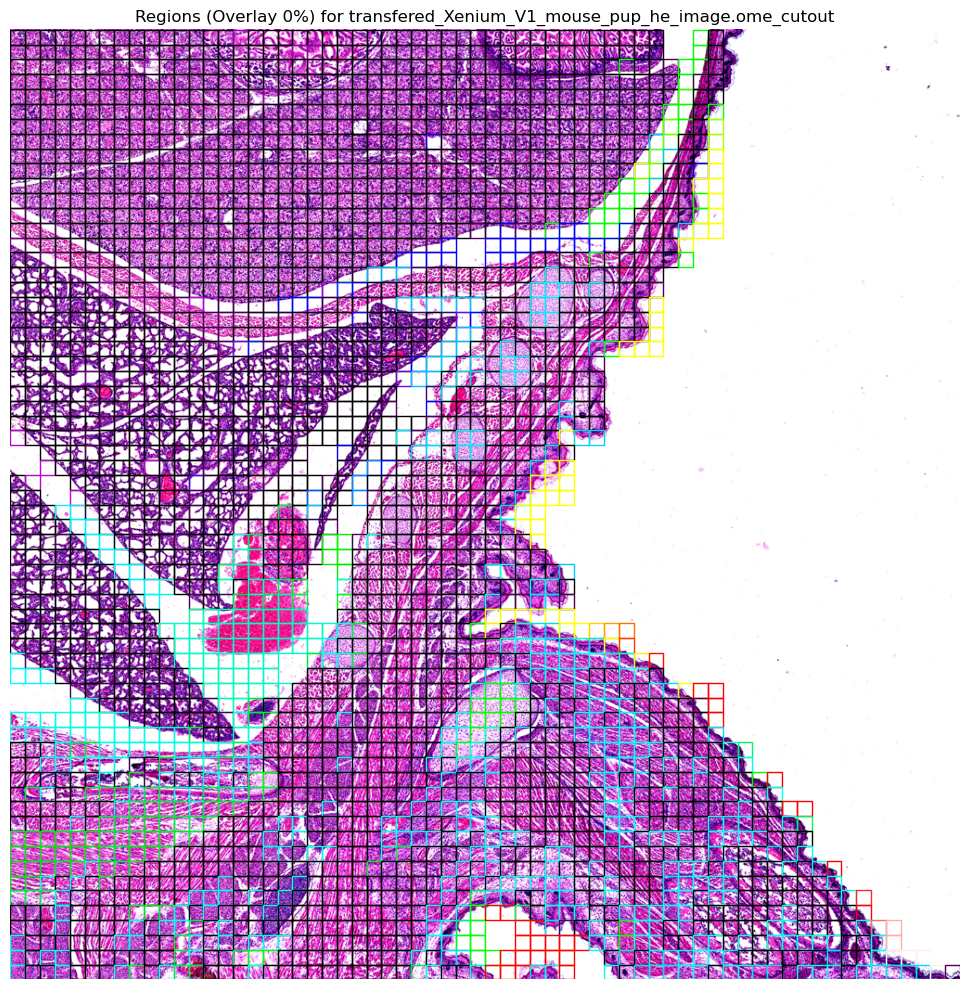

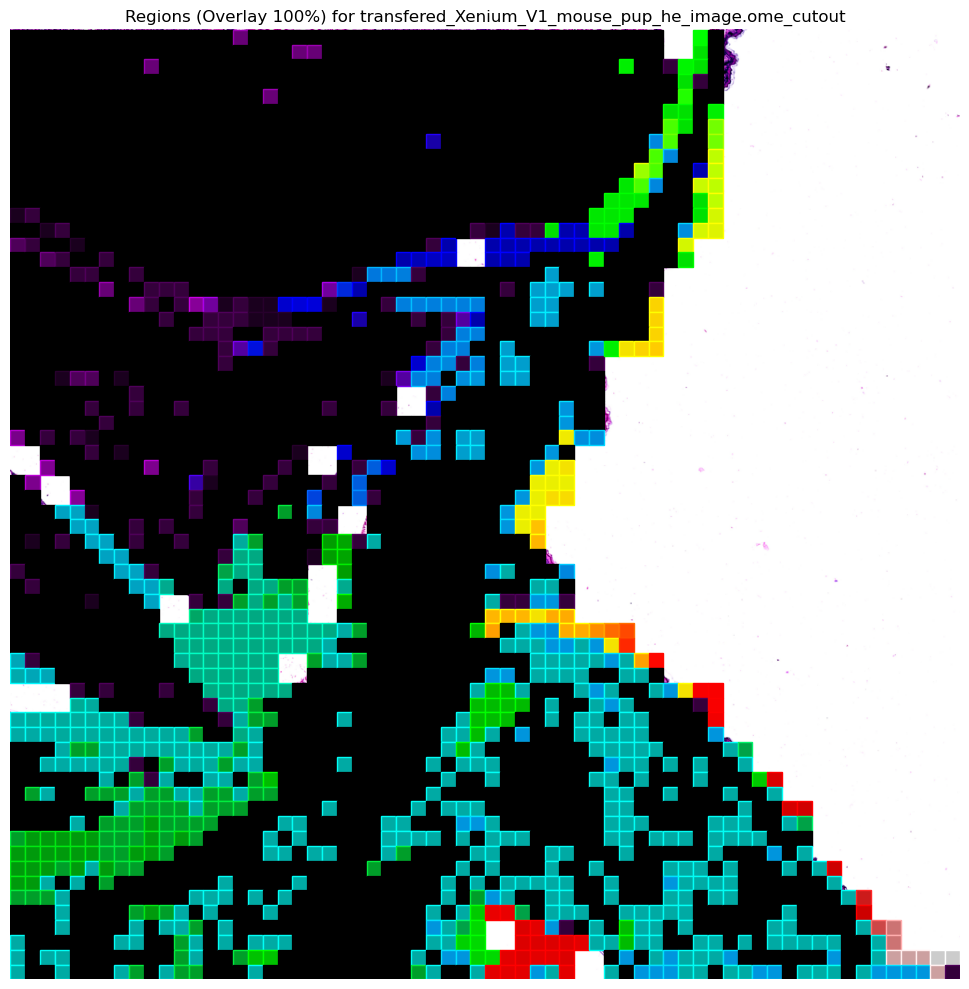

Done with image #5 (WMPP017) | Time taken: 25.8
Saved cluster → patch mapping to cluster_to_patch_ids_WMPP017.json
../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/PDHP030/transfered_Xenium_Prime_Human_Prostate_FFPE_he_image.ome.tif
Center crop saved. Top-left corner: (5129, 1745), Size: 3491x3491
Estimated no. of patches: 324
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/PDHP030/transfered_Xenium_Prime_Human_Prostate_FFPE_he_image.ome_cutout.jpg
WSI Width: 13749 | WSI Height: 6982
Minimum region size = 30
Done resizing image.
❗ WARNING: patch_637.tif already assigned to Cluster 1, skipping for Cluster 0
❗ WARNING: patch_639.tif already assigned to Cluster 0, skipping for Cluster 1
❗ WARNING: patch_706.tif already assigned to Cluster 1, skipping for Cluster 0
❗ WARNING: patch_773.tif already assigned to Cluster 0, skipping for Cluster 1
❗ WARNING: patch_774.tif already assigned to Cluster 3, skipping for Clu

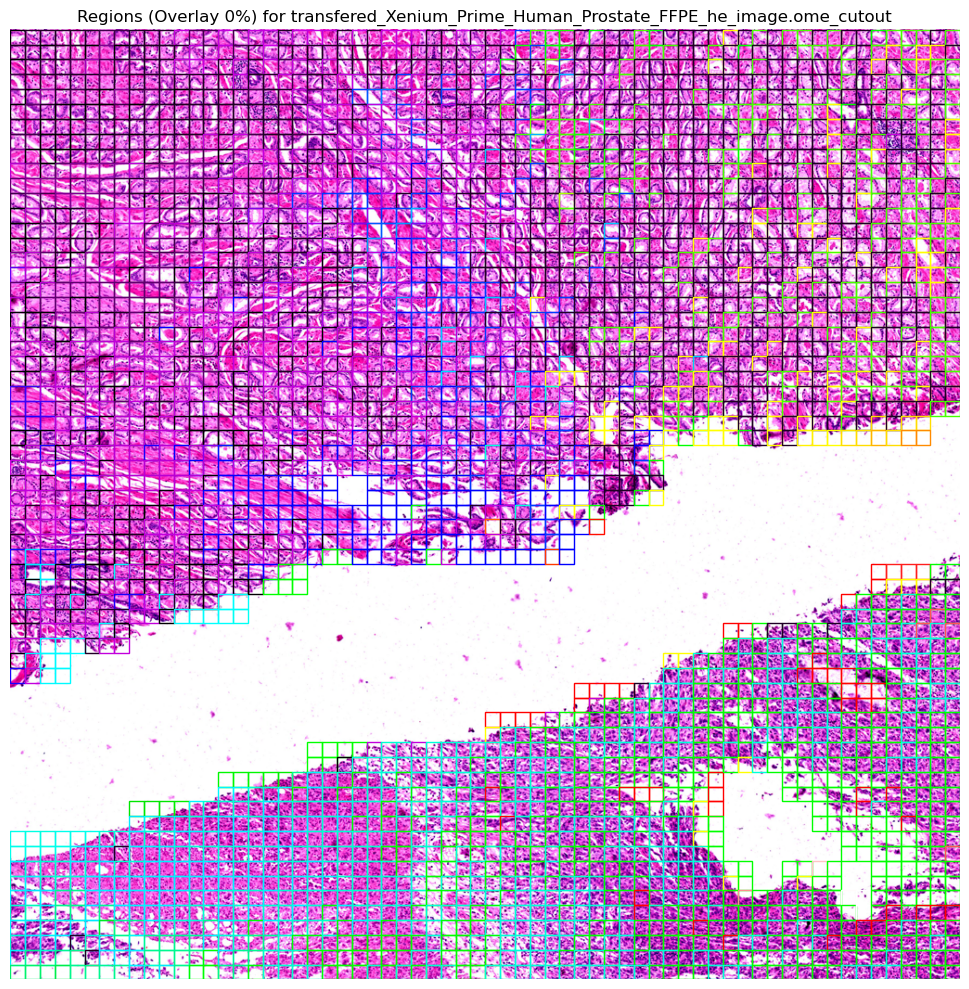

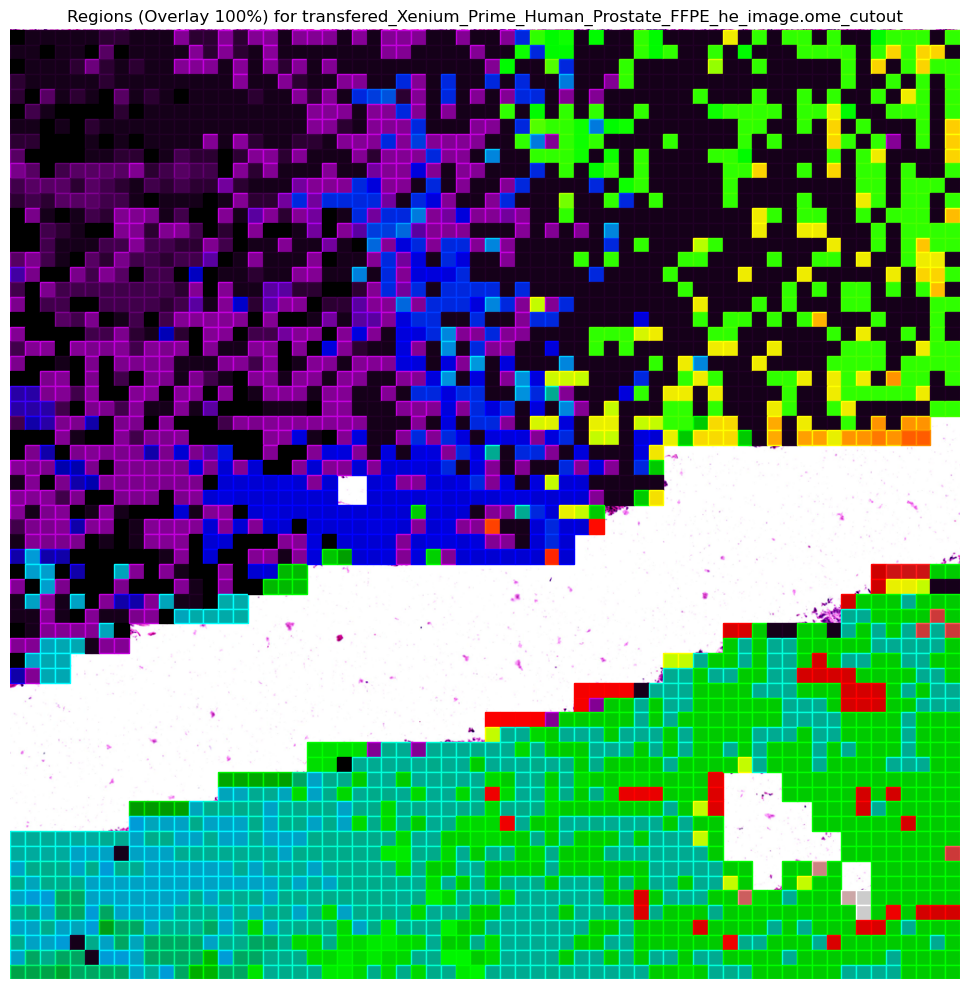

Done with image #6 (PDHP030) | Time taken: 28.1
Saved cluster → patch mapping to cluster_to_patch_ids_PDHP030.json
../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/PDHS029/transfered_Xenium_Prime_Human_Skin_FFPE_he_image.ome.tif
Center crop saved. Top-left corner: (3622, 1303), Size: 2606x2606
Estimated no. of patches: 196
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/PDHS029/transfered_Xenium_Prime_Human_Skin_FFPE_he_image.ome_cutout.jpg
WSI Width: 9850 | WSI Height: 5213
Minimum region size = 40
Done resizing image.
❗ WARNING: patch_411.tif already assigned to Cluster 0, skipping for Cluster 1
❗ WARNING: patch_413.tif already assigned to Cluster 0, skipping for Cluster 2
❗ WARNING: patch_414.tif already assigned to Cluster 0, skipping for Cluster 2
❗ WARNING: patch_872.tif already assigned to Cluster 2, skipping for Cluster 10
❗ WARNING: patch_874.tif already assigned to Cluster 2, skipping for Cluster 11


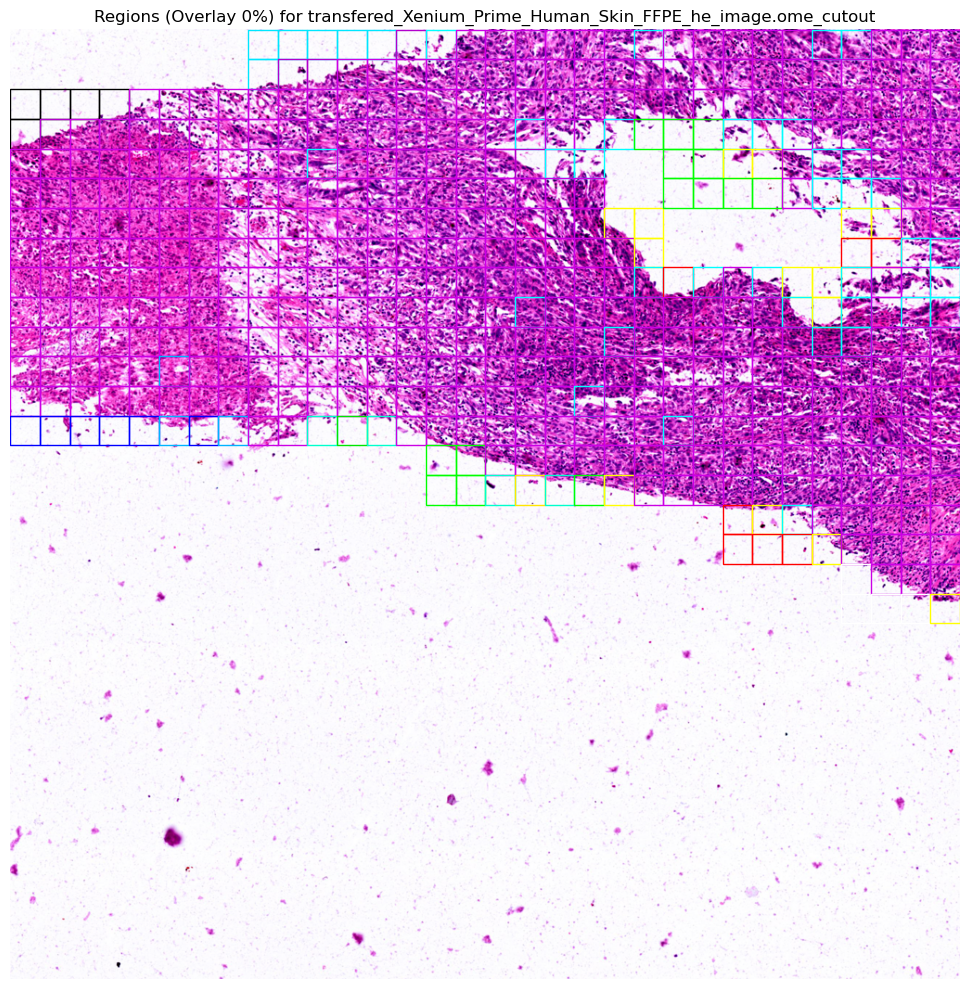

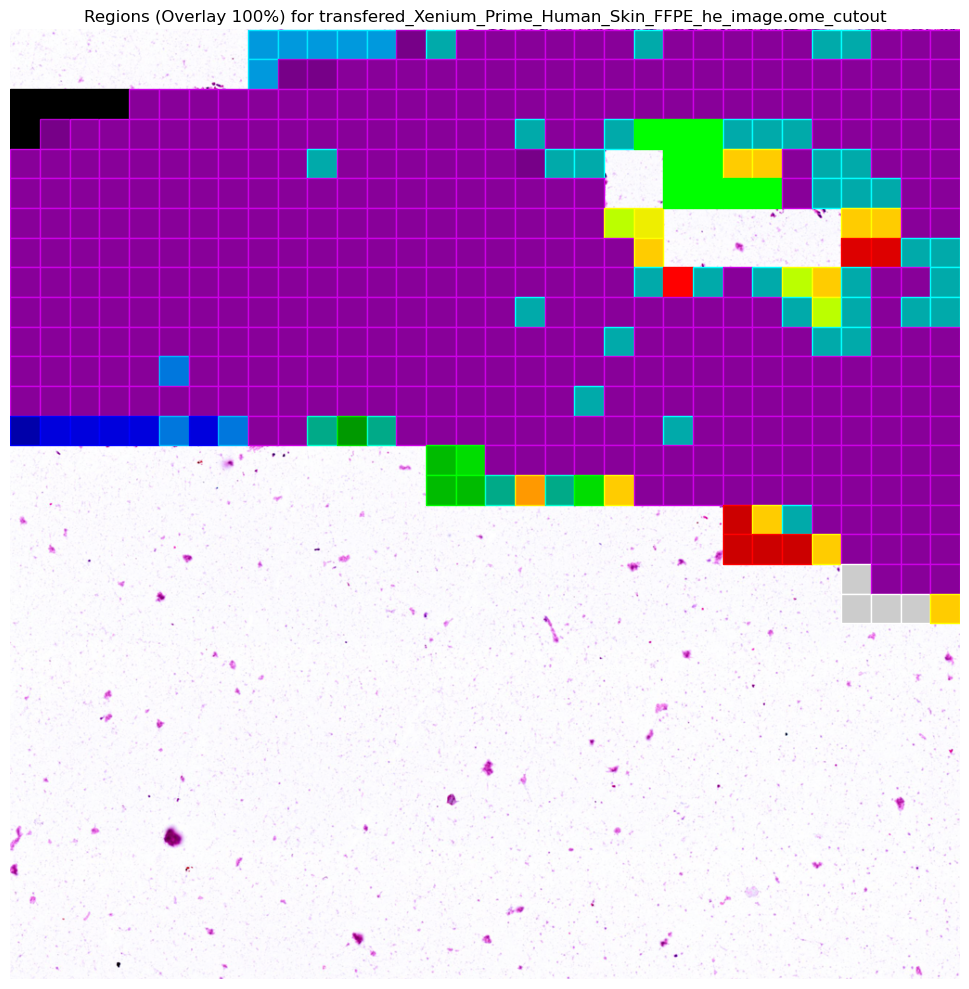

Done with image #7 (PDHS029) | Time taken: 5.8
Saved cluster → patch mapping to cluster_to_patch_ids_PDHS029.json
../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/HHDX011/transfered_Xenium_V1_hHeart_nondiseased_section_FFPE_he_image.ome.tif
Center crop saved. Top-left corner: (733, 2630), Size: 1465x1465
Estimated no. of patches: 64
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/HHDX011/transfered_Xenium_V1_hHeart_nondiseased_section_FFPE_he_image.ome_cutout.jpg
WSI Width: 2931 | WSI Height: 6726
Minimum region size = 70
Done resizing image.


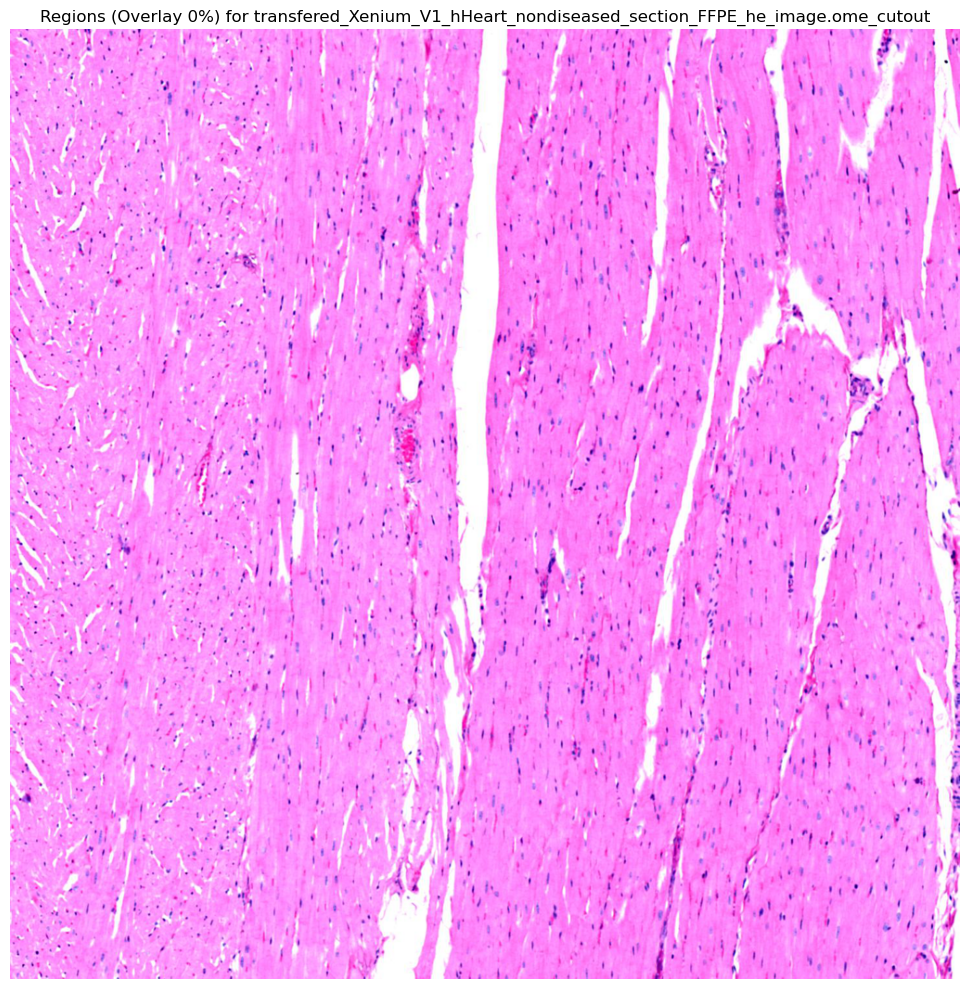

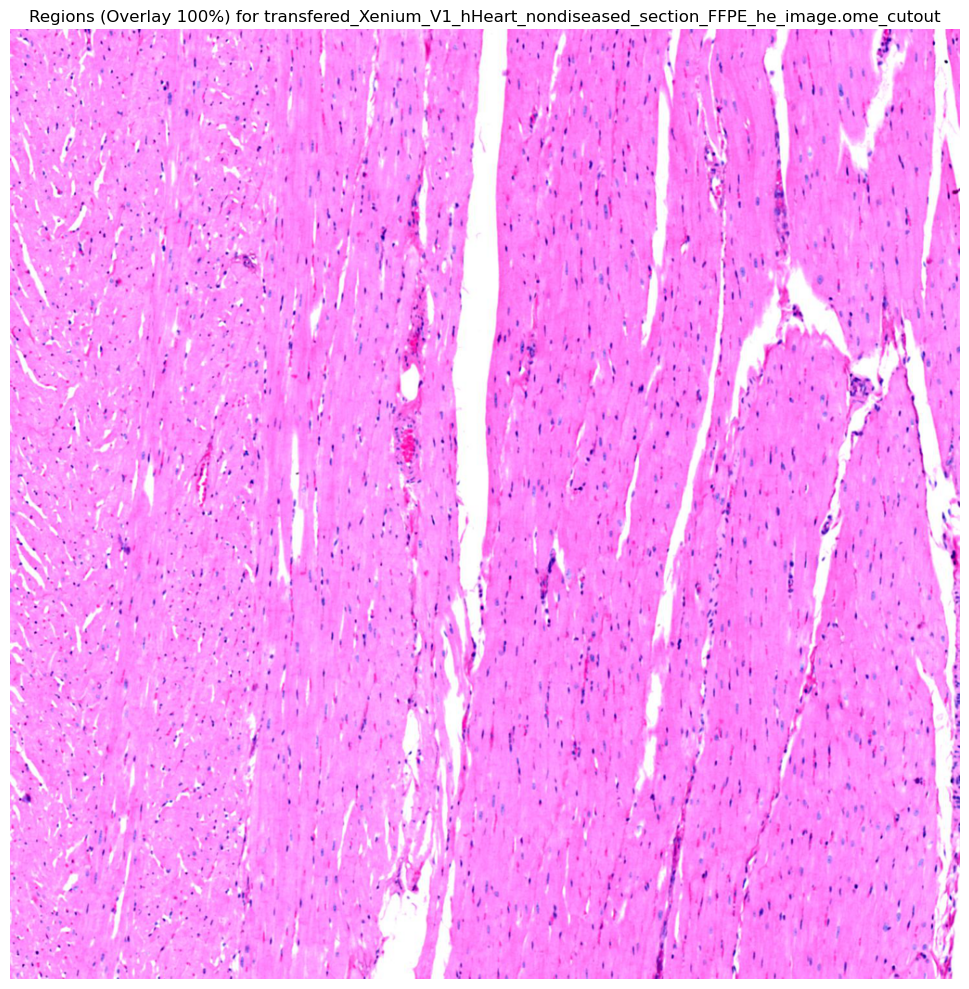

Done with image #8 (HHDX011) | Time taken: 0.7
Saved cluster → patch mapping to cluster_to_patch_ids_HHDX011.json
../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/HPXM007/transfered_Xenium_V1_human_Pancreas_FFPE_he_image.ome.tif
Center crop saved. Top-left corner: (2747, 1024), Size: 2047x2047
Estimated no. of patches: 121
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/HPXM007/transfered_Xenium_V1_human_Pancreas_FFPE_he_image.ome_cutout.jpg
WSI Width: 7541 | WSI Height: 4095
Minimum region size = 51
Done resizing image.
❗ WARNING: patch_273.tif already assigned to Cluster 1, skipping for Cluster 0
❗ WARNING: patch_275.tif already assigned to Cluster 1, skipping for Cluster 0
❗ WARNING: patch_276.tif already assigned to Cluster 0, skipping for Cluster 2
❗ WARNING: patch_206.tif already assigned to Cluster 2, skipping for Cluster 0
❗ WARNING: patch_278.tif already assigned to Cluster 0, skipping for Cluster 2
❗

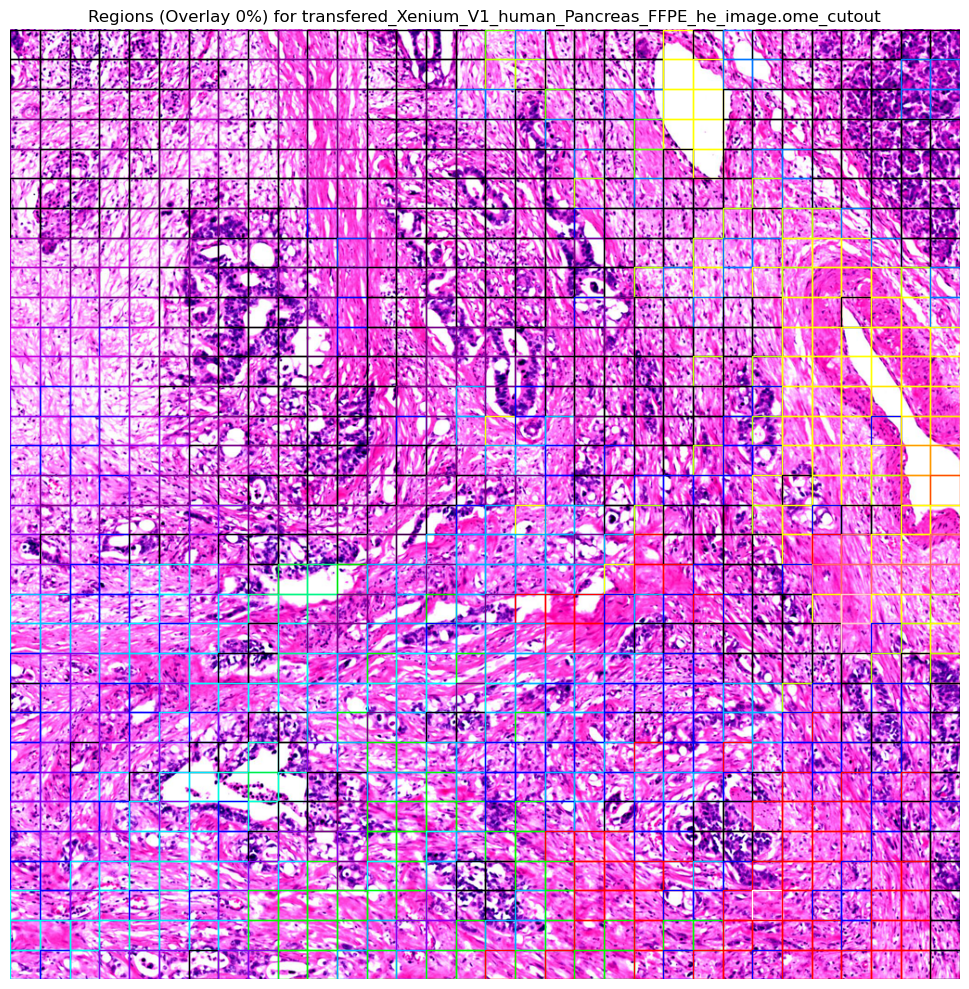

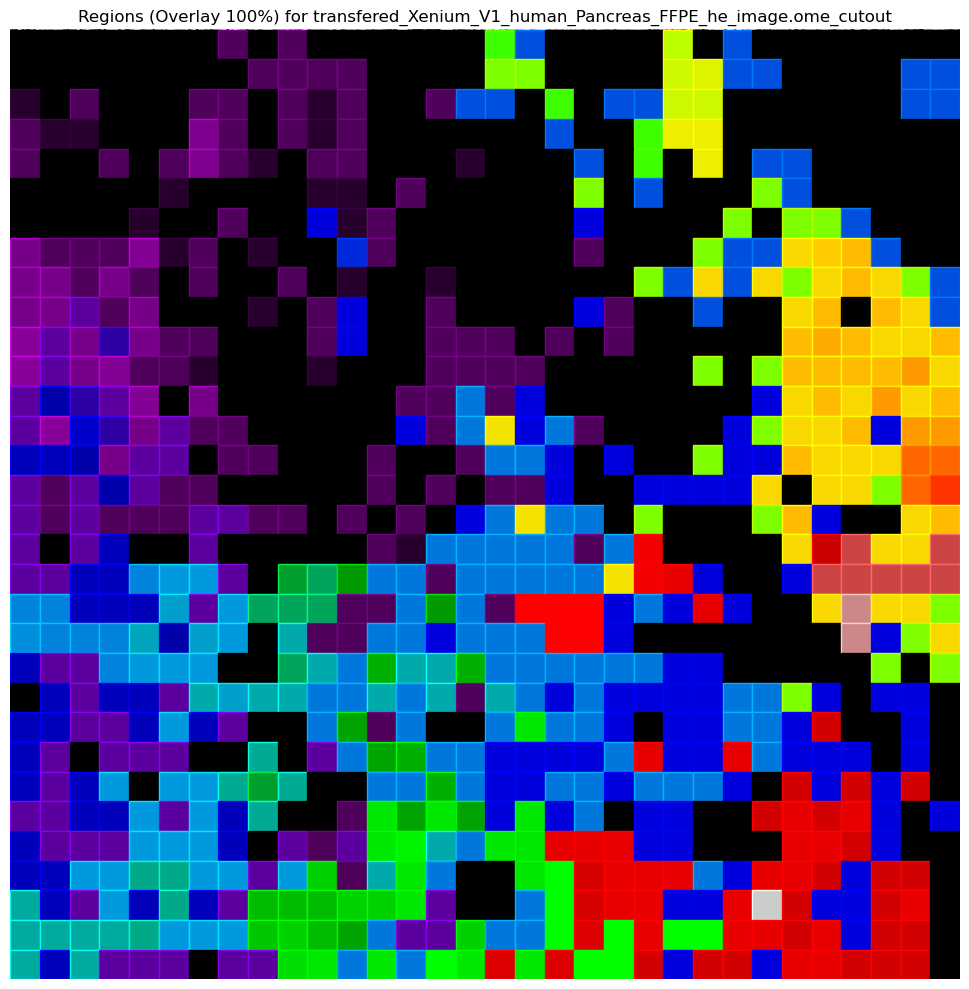

Done with image #9 (HPXM007) | Time taken: 9.4
Saved cluster → patch mapping to cluster_to_patch_ids_HPXM007.json
../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/HSDX009/transfered_Xenium_V1_hSkin_nondiseased_section_1_FFPE_he_image.ome.tif
Center crop saved. Top-left corner: (3983, 2220), Size: 4440x4440
Estimated no. of patches: 529
Saved enhanced center crop to ../../../../../../extra/zhanglab0/xil43/Xenium/CellNet_data/aligned_hne/HSDX009/transfered_Xenium_V1_hSkin_nondiseased_section_1_FFPE_he_image.ome_cutout.jpg
WSI Width: 12406 | WSI Height: 8881
Minimum region size = 24
Done resizing image.
❗ WARNING: patch_703.tif already assigned to Cluster 0, skipping for Cluster 2
❗ WARNING: patch_704.tif already assigned to Cluster 0, skipping for Cluster 2
❗ WARNING: patch_825.tif already assigned to Cluster 1, skipping for Cluster 0
❗ WARNING: patch_826.tif already assigned to Cluster 1, skipping for Cluster 0
❗ WARNING: patch_949.tif already assigned to Cluster 

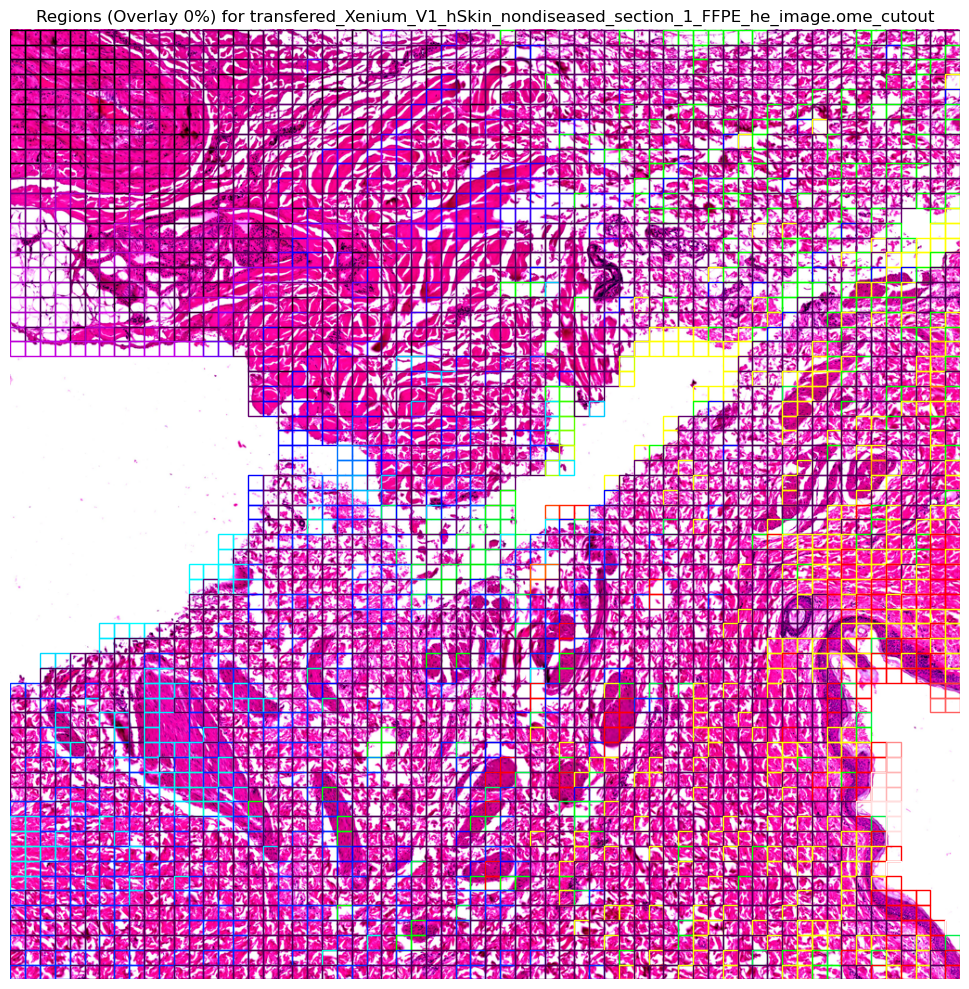

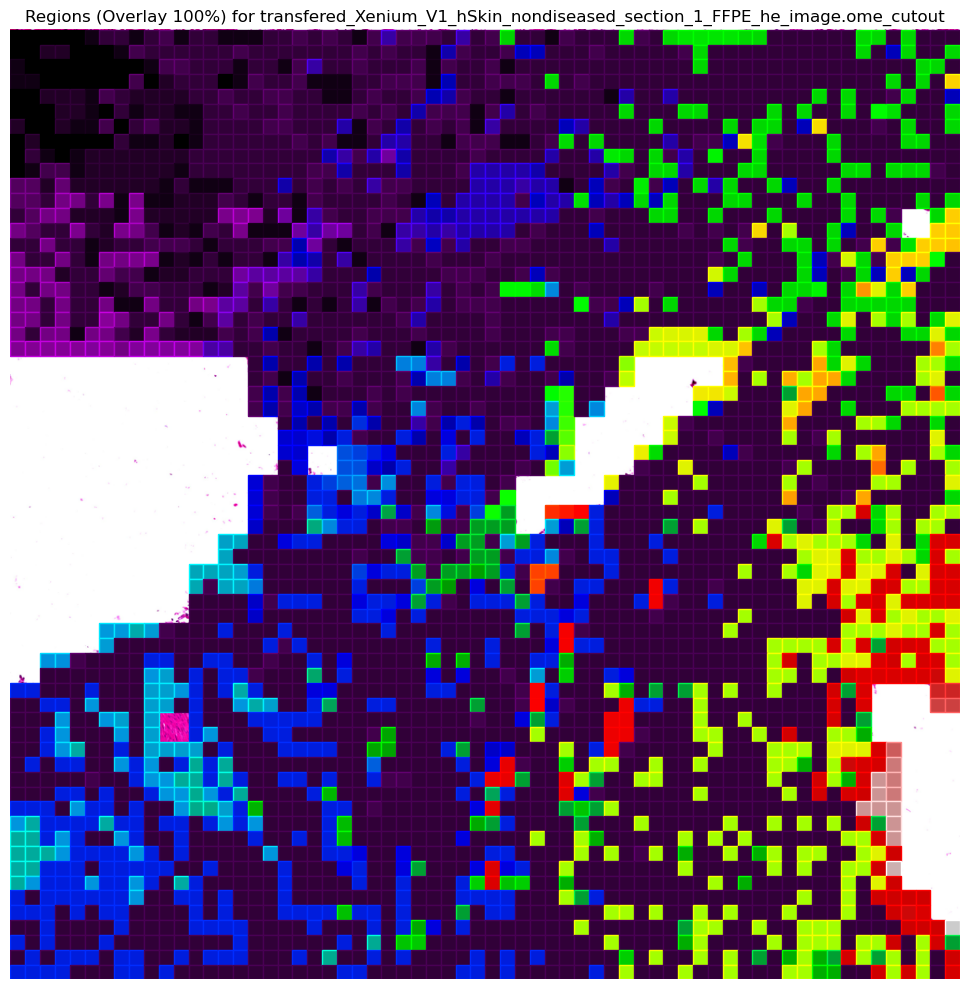

Done with image #10 (HSDX009) | Time taken: 31.5
Saved cluster → patch mapping to cluster_to_patch_ids_HSDX009.json


In [10]:
for i, wsi_image_path in enumerate(WSI_paths):

    print(wsi_image_path)

    # === CROPPING THE WSI ===
    wsi_width, wsi_height, top_left, image_path = crop_and_enhance(wsi_image_path)
    print(f"WSI Width: {wsi_width} | WSI Height: {wsi_height}")

    # === PARAMETERS ===
    resize_dim = 1024
    min_size = math.ceil(200 / min(wsi_width, wsi_height) * resize_dim)
    sim_threshold = 0.999
    print(f"Minimum region size = {min_size}")

    # === EXECUTION ===
    cluster_to_patch_ids = {}  # 🧠 NEW: Mapping cluster → list of patch IDs
            
    start_time = time.time()
    regions, img_np = process_image(
        image_path, 
        resize_to=resize_dim, 
        min_patch_size=min_size, 
        similarity_threshold=sim_threshold,
        to_split=False, 
        initial_split_factor=4
    )
    img_diagonal = np.sqrt(img_np.shape[0]**2 + img_np.shape[1]**2)
    final_labels = merge_clusters_with_dp(
        regions,
        img_diagonal,
        sim_thresholds={'color': 0.8},
        distance_threshold=0.03,
    )

    # 🧠 NEW: Compute patch IDs for each region, corrected using topleft offset
    patch_w = patch_h = 200  # WSI patch size
    x0_crop, y0_crop = top_left

    # Load the JPEG and WSI crop to get dimensions
    resized_width, resized_height = resize_dim, resize_dim
    wsi_crop_width, wsi_crop_height = wsi_width, wsi_height  # already returned from crop_and_enhance()

    scale_x = wsi_crop_width / resized_width
    scale_y = wsi_crop_height / resized_height

    num_cols = wsi_crop_width // patch_w
    patch_to_cluster = {}

    for region, label in zip(regions, final_labels):
        # Reverse scale the coordinates back to WSI crop resolution
        x_rescaled = region["x"] * scale_x
        y_rescaled = region["y"] * scale_y

        # Shift to global WSI coordinates
        x_global = x_rescaled + x0_crop
        y_global = y_rescaled + y0_crop

        # Map to patch grid
        patch_col = int(x_global) // patch_w
        patch_row = int(y_global) // patch_h
        patch_name = f"patch_{patch_row * num_cols + patch_col}.tif"

        if patch_name in patch_to_cluster:
            if patch_to_cluster[patch_name] != label:
                print(f"❗ WARNING: {patch_name} already assigned to Cluster {patch_to_cluster[patch_name]}, skipping for Cluster {label}")
            continue

        patch_to_cluster[patch_name] = label

        if label not in cluster_to_patch_ids:
            cluster_to_patch_ids[label] = []
        cluster_to_patch_ids[label].append(patch_name)


    end_time = time.time()
    
    visualize_regions(image_path, regions, final_labels, img_np, base_overlay=0.0)
    
    wsi_id = wsi_image_path.split("/")[12]
    print(f"Done with image #{i+1} ({wsi_id}) | Time taken: {round(end_time-start_time, 1)}")

    # 🔍 Optionally print or save the result
    with open(f"cluster_to_patch_ids_{wsi_id}.json", "w") as f:
        json.dump(cluster_to_patch_ids, f, indent=2)
    print(f"Saved cluster → patch mapping to cluster_to_patch_ids_{wsi_id}.json")